# <center><font color=darkblue> CoVID-19 - A Mobility Perspective</font></center>
# <center><font color=darkblue> Causal Analysis Of CoVID-19 based on Mobility Patterns</font></center>
# <center><font color=darkblue> Archana Krishnamurthy (Akrishn@iu.edu / archanakrishnamurthy86@gmail.com)</font></center>
# <center><font color=darkblue> I -590 Data Viz </font></center>

In [1]:
# Loading all necessary libraries for python, pandas, numpy
import pandas as pd
import numpy as np
import re
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from collections import Counter
from math import pi
from matplotlib import colors as mcolors
pd.options.display.precision
pd.set_option('display.float_format', lambda x: '%.7f' % x)

In [2]:
# Initializing Bokeh resources inline
from bokeh.resources import INLINE,CDN
import bokeh.io
bokeh.io.output_notebook(INLINE)

Loading BokehJS ...

In [3]:
# Streatch and Display notebook
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:98% !important; }</style>"))

In [4]:
# Importing necessary libraries for Bokeh
from bokeh.plotting import figure
from bokeh.models import Title,ColumnDataSource, LinearColorMapper, ColorBar, BasicTicker, PrintfTickFormatter,HoverTool,LinearAxis, Range1d,LogAxis,Panel,RadioButtonGroup,CheckboxButtonGroup ,Tabs,CheckboxGroup,CDSView,CustomJS,CustomJSFilter,GeoJSONDataSource,Slider,LogColorMapper,Label,LabelSet,Text, Div
from bokeh.palettes import Viridis256,brewer,YlOrRd9,YlGnBu,Spectral3,Spectral6,magma,viridis,cividis,YlOrRd,RdYlGn,Category20_20,Category20b
from bokeh.transform import transform,linear_cmap,cumsum
from bokeh.layouts import column, row, WidgetBox,grid, layout
from bokeh.io import push_notebook, show, output_notebook,output_file,save
from ipywidgets import interact
from bokeh.application.handlers import FunctionHandler
from bokeh.application import Application

# Abstract

The current outbreak of novel coronavirus (2019-nCoV or SARS-CoV-2) in China and globally has caused an uproar all over the world and was declared a pandemic in March 2020. There are a lot of unknowns around this virus and its spread, that numerous visualization efforts to understand the growth and spread of this virus is still not sufficient to paint a complete picture. In this paper an endeavor has made to provide another point of view on how the spread of this virus can be interpreted by the means of unique visualizations such as choropleths and interactive visuals using bokeh, availing the covid data from The New York Times, based on reports from state and local health agencies ,google mobility information and open table data. Furthermore, in an effort to understand the effect of mobility on the pandemic, causal analysis has been applied to the datasets categorized by states. 

## <font color=darkgreen> 1. Loading datasets</font>

### <font color=grey> A.Loading data for Number of Covid cases per state from the NY Times</font>

In [5]:
# Load data from NY times : https://github.com/nytimes/covid-19-data
import datetime
data_cases = pd.read_csv('us-states_new.csv')
data_cases['date']=pd.to_datetime(data_cases['date'], format = '%m/%d/%Y')
data_cases['Week']=data_cases['date'].dt.week
data_cases['Day']=data_cases['date'].dt.day
data_cases['Month']=data_cases['date'].dt.month
data_cases.set_index(['date', 'state'])
data_cases.head(2)

,date,state,fips,cases,deaths,Week,Day,Month
0,2020-01-21,Washington,53,1,0,4,21,1
1,2020-01-22,Washington,53,1,0,4,22,1


In [6]:
# Loading the united states population data to represent the case ratio per capita
data_population = pd.read_csv('us-population.csv', index_col=['state'])
data_population.head(2)

,population
state,
California,39776830
Texas,28704330


### <font color=grey>B.Loading data for 49 states</font>

In [7]:
# Loading the united states list of states to be filtered upon
data_maps = pd.read_csv('us-contiguous-states.csv', index_col=['state'])
data_maps.head(2)

,id,data,r,g,b
state,,,,,
Alabama,1,9,0.5000000,0.5000000,0.5000000
Arizona,2,11,0.7000000,0.1000000,0.3000000


In [8]:
# Merging the datasets
data_maps_pop=data_population.merge(data_maps, left_on='state', right_on='state')
data_covid=data_maps_pop.merge(data_cases, left_on='state', right_on='state')
data_covid.drop(columns=['data', 'r','g','b','id'],inplace=True)
data_covid.head(2)

,state,population,date,fips,cases,deaths,Week,Day,Month
0,California,39776830,2020-01-25,6,1,0,4,25,1
1,California,39776830,2020-01-26,6,2,0,4,26,1


### <font color=grey>C. Data Preparation </font>

In [9]:
# Calculating cumulative case ratio per capita , based on the data from NY times
data_covid['caseratiocumulative']=data_covid['cases']/(data_covid['population']/1000000)
data_covid=data_covid.sort_values(by=['state','date'], ascending=True)

In [10]:
#Calculating the case ratio per day, by substracting the difference per day by grouping each state
data_covid['caseperday']=data_covid.groupby(['state'])['cases'].transform(lambda x: x.diff()) 
# Creating a function to handle the first value in each group
data_covid=data_covid.sort_values(by=['state','date'], ascending=True)
def funchandlefstval(group):
    if group.caseperday.values[0]!=group.cases.values[0]:
        group.caseperday.values[0] = group.cases.values[0]
    return group
data_covid=data_covid.groupby('state').apply(funchandlefstval)
# Scaling the value to population per million to compare the states
data_covid['caseperdayratio']=data_covid['caseperday']/(data_covid['population']/1000000)
#Calculating the case percentage change by a fortnight within each state
data_covid['casepctchangebyfortnight']=data_covid.groupby(['state'])['cases'].transform(lambda x: x.pct_change(14,fill_method='ffill')) 
data_covid.tail(5)

,state,population,date,fips,cases,deaths,Week,Day,Month,caseratiocumulative,caseperday,caseperdayratio,casepctchangebyfortnight
6939,Wyoming,573720,2020-07-16,56,2026,24,29,16,7,3531.3393293,41.0000000,71.4634316,0.3070968
6940,Wyoming,573720,2020-07-17,56,2069,24,29,17,7,3606.2887820,43.0000000,74.9494527,0.3078382
6941,Wyoming,573720,2020-07-18,56,2108,24,29,18,7,3674.2661926,39.0000000,67.9774106,0.3125778
6942,Wyoming,573720,2020-07-19,56,2126,24,29,19,7,3705.6403821,18.0000000,31.3741895,0.3011016
6943,Wyoming,573720,2020-07-20,56,2187,24,30,20,7,3811.9640243,61.0000000,106.3236422,0.3056716


In [11]:
#Rank based on cumulative case ratio to be used for the multi-line plot
data_covid["rankrev1"] =data_covid.groupby("date")["caseratiocumulative"].rank("dense", ascending=True)
data_covid["rank1"] =data_covid.groupby("date")["caseratiocumulative"].rank("dense", ascending=False)

In [12]:
#Rank based on case ratio per day
data_covid["rankrev2"] =data_covid.groupby("date")["caseperdayratio"].rank("dense", ascending=True)
data_covid["rank2"] =data_covid.groupby("date")["caseperdayratio"].rank("dense", ascending=False)

In [13]:
data_covid.head(2)

,state,population,date,fips,cases,deaths,Week,Day,Month,caseratiocumulative,caseperday,caseperdayratio,casepctchangebyfortnight,rankrev1,rank1,rankrev2,rank2
3419,Alabama,4888949,2020-03-13,1,6,0,11,13,3,1.2272576,6.0000000,1.2272576,nan,5.0000000,44.0000000,21.0000000,20.0000000
3420,Alabama,4888949,2020-03-14,1,12,0,11,14,3,2.4545153,6.0000000,1.2272576,nan,11.0000000,38.0000000,19.0000000,24.0000000


In [14]:
# Cumulative case dataframe
data_covid_perdaycumulative=data_covid.loc[:,['state','population','date','cases','caseratiocumulative','rankrev1','rank1']]
data_covid_perdaycumulative.head(2)

,state,population,date,cases,caseratiocumulative,rankrev1,rank1
3419,Alabama,4888949,2020-03-13,6,1.2272576,5.0000000,44.0000000
3420,Alabama,4888949,2020-03-14,12,2.4545153,11.0000000,38.0000000


In [15]:
# Per day cases dataframe
data_covid_perday=data_covid.loc[:,['state','population','date','caseperday','caseperdayratio','cases','Week','Month','rankrev2','rank2']]
data_covid_perday.head(2)

,state,population,date,caseperday,caseperdayratio,cases,Week,Month,rankrev2,rank2
3419,Alabama,4888949,2020-03-13,6.0000000,1.2272576,6,11,3,21.0000000,20.0000000
3420,Alabama,4888949,2020-03-14,6.0000000,1.2272576,12,11,3,19.0000000,24.0000000


In [16]:
# Creating a dataframe with case ratio rolled up to the week level
data_covid_temp=data_covid_perday.loc[:,['state','population','Week','caseperday']]
data_covid_perweek=data_covid_temp.groupby(['state','Week','population'])[['caseperday']].sum()
data_covid_perweek.reset_index(inplace=True)
data_covid_perweek.rename(columns={'caseperday': 'caseperweek'},inplace=True)
data_covid_perweek['caseperweekratio']=data_covid_perweek['caseperweek']/(data_covid_perweek['population']/1000000)
data_covid_perweek['rankrev3'] =data_covid_perweek.groupby('Week')['caseperweekratio'].rank("dense", ascending=True)
data_covid_perweek['rank3'] =data_covid_perweek.groupby('Week')['caseperweekratio'].rank("dense", ascending=False)
data_covid_perweek.head(2)

,state,Week,population,caseperweek,caseperweekratio,rankrev3,rank3
0,Alabama,11,4888949,23.0000000,4.7044876,16.0000000,33.0000000
1,Alabama,12,4888949,134.0000000,27.4087539,18.0000000,32.0000000


In [17]:
# Creating a dataframe with case ratio rolled up to the month level
data_covid_temp=data_covid_perday.loc[:,['state','population','Month','caseperday']]
data_covid_perMonth=data_covid_temp.groupby(['state','Month','population'])[['caseperday']].sum()
data_covid_perMonth.reset_index(inplace=True)
data_covid_perMonth.rename(columns={'caseperday': 'casepermonth'},inplace=True)
data_covid_perMonth['caseperMonthratio']=data_covid_perMonth['casepermonth']/(data_covid_perMonth['population']/1000000)
data_covid_perMonth['rankrev4'] =data_covid_perMonth.groupby('Month')['caseperMonthratio'].rank("dense", ascending=True)
data_covid_perMonth['rank4'] =data_covid_perMonth.groupby('Month')['caseperMonthratio'].rank("dense", ascending=False)
data_covid_perMonth=data_covid_perMonth.sort_values(by=['state','Month'], ascending=True)
data_covid_perMonth.head(2)

,state,Month,population,casepermonth,caseperMonthratio,rankrev4,rank4
0,Alabama,3,4888949,999.0000000,204.3383967,19.0000000,31.0000000
1,Alabama,4,4888949,6069.0000000,1241.3711004,20.0000000,30.0000000


## <font color=darkgreen> 2. Visualizing the most and least affected states based on the cumulative Covid-19 case ratio </font>

In [18]:
# choosing the rows of higher cumulative case ratio values from the dataframe
data_covid_perdaycumulativetemp1=data_covid_perdaycumulative[(data_covid_perdaycumulative['rank1']<=5)]
data_covid_perdaycumulativetemp1['state'].unique()
data_covid_perdaycumulativetemp1= data_covid_perdaycumulative[data_covid_perdaycumulative.state.isin(data_covid_perdaycumulativetemp1['state'].unique())]

In [19]:
#transpose cumulative plot to produce multiple bokeh lines
data_covid_perdaycumulativeP=data_covid_perdaycumulativetemp1.loc[:,['date','state','caseratiocumulative']]
data_covid_perdaycumulativeP=data_covid_perdaycumulativeP.pivot(index='date',columns='state', values='caseratiocumulative')
data_covid_perdaycumulativeP.reset_index(inplace=True)
data_covid_perdaycumulativeP = data_covid_perdaycumulativeP.rename_axis("idx", axis="columns")
data_covid_perdaycumulativeP.tail(2)

idx,date,Arizona,California,Colorado,Connecticut,District of Columbia,Florida,Illinois,Louisiana,Massachusetts,...,New Hampshire,New Jersey,New York,Oregon,Rhode Island,South Dakota,Texas,Utah,Washington,Wisconsin
180,2020-07-19,20163.6800527,9841.4076738,7069.0649155,13345.5643756,16004.6503167,16424.3400180,12763.0729806,19608.2911960,16463.9452592,...,4592.8585973,19789.6084435,20718.1750224,3473.2185230,16758.7820426,9006.7100332,11776.4811093,10798.7573374,6453.8429587,7898.3521796
181,2020-07-20,20398.9445104,10061.0078782,7151.2224317,13390.7062842,16115.5074985,16909.8363375,12861.8330368,20288.6956544,16500.9236625,...,4626.9181645,19809.5356604,20744.3046479,3570.1333686,16863.3301686,9048.8613450,12042.5036920,10928.2145508,6632.8471007,8036.0271974


In [20]:
import bokeh.plotting as bop

In [21]:
# Plot 1 for line plot with interactive feature
def bkplt1():
    col = []

    # Prep data
    # remove unwanted columns
    numlines = len(data_covid_perdaycumulativeP.columns)-1
    dfp1=data_covid_perdaycumulativeP
    [col.append(i) for i in dfp1.columns[1:]]

    #import color pallete
    mypalette = Category20_20[0:numlines]


    # make the figure
    TOOLS = 'crosshair,save,pan,box_zoom,reset,wheel_zoom'
    p1 = figure(title="States with High case Ratio (Covid-19)", y_axis_type="log",x_axis_type='datetime'
               , tools = TOOLS, plot_width=1000, plot_height=700 )
        # loop through our columns and colours
    line_dash_styles = [[10, 0], [20, 1], [10, 1], [5, 1]]
    for (columnnames, colore,line_dash ) in zip(col, mypalette, itertools.cycle(line_dash_styles)):
        line=p1.line(dfp1.date, dfp1[columnnames], legend_label = columnnames, color = colore , line_width=2,line_dash=line_dash)
        hover = HoverTool(tooltips=[('State', columnnames)],renderers=[line])
        p1.add_tools(hover)
    p1.xaxis.axis_label = 'Date'
    p1.xaxis.axis_label_text_font = "Segoe UI"
    p1.yaxis.axis_label = 'Case Ratio'
    p1.yaxis.axis_label_text_font = "Segoe UI"
    p1.yaxis.major_label_orientation = "vertical"
    p1.xaxis.axis_line_width = 0.5
    p1.xaxis.axis_line_color = "black"
    p1.yaxis.major_label_text_color = "Black"
    p1.title.text_color = "Black"
    p1.title.text_font = "Segoe UI"
    p1.title.text_font_style = "bold italic"
    p1.title.align ='center'
    p1.title.text_font_size="10pt"
    p1.background_fill_alpha = 0.1
    p1.border_fill_color = "whitesmoke"
    p1.min_border_left = 20
    p1.outline_line_width = 1
    p1.outline_line_alpha = 0.5
    p1.outline_line_color = "grey"
    # Define Legend
    p1.legend.location = "top_left"
    p1.legend.click_policy="hide"
    p1.legend.inactive_fill_color='gray'
    p1.legend.inactive_fill_alpha=0.4
    p1.legend.label_text_font_size ="8pt"
    p1.legend.title = 'States'
    p1.legend.title_text_font = "bold italic"
    p1.add_layout(Title(text="Figure 1", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
    return p1

In [22]:
bkplt1()

Figure(id='1002', ...)

In [23]:
data_covid_perdaycumulativetemp2=data_covid_perdaycumulative[(data_covid_perdaycumulative['rank1']>=44)]
data_covid_perdaycumulativetemp2['state'].unique()

array(['Alabama', 'Arizona', 'Arkansas', 'Idaho', 'Indiana', 'Iowa',
       'Kansas', 'Kentucky', 'Maine', 'Minnesota', 'Mississippi',
       'Missouri', 'Montana', 'Nebraska', 'North Carolina',
       'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'South Dakota',
       'Texas', 'Vermont', 'Virginia', 'West Virginia', 'Wyoming'],
      dtype=object)

In [24]:
# choosing the rows of lower cumulative case ratio values from the dataframe
data_covid_perdaycumulativetemp2= data_covid_perdaycumulative[data_covid_perdaycumulative.state.isin(data_covid_perdaycumulativetemp2['state'].unique())]
data_covid_perdaycumulativeL=data_covid_perdaycumulativetemp2.loc[:,['date','state','caseratiocumulative']]
data_covid_perdaycumulativeL=data_covid_perdaycumulativeL.pivot(index='date',columns='state', values='caseratiocumulative')
data_covid_perdaycumulativeL.reset_index(inplace=True)
data_covid_perdaycumulativeL = data_covid_perdaycumulativeL.rename_axis("idx", axis="columns")
data_covid_perdaycumulativeL.tail(2)

idx,date,Alabama,Arizona,Arkansas,Idaho,Indiana,Iowa,Kansas,Kentucky,Maine,...,North Dakota,Ohio,Oklahoma,Oregon,South Dakota,Texas,Vermont,Virginia,West Virginia,Wyoming
175,2020-07-19,13706.6269253,20163.6800527,11001.4577892,8529.7572212,8651.9716241,12280.4458587,7695.3519170,5276.9681582,2748.2479640,...,6650.8835625,6407.3666417,6411.5887214,3473.2185230,9006.7100332,11776.4811093,2163.6002308,9081.9948250,2796.3309387,3705.6403821
176,2020-07-20,14091.1676518,20398.9445104,11232.8896838,8769.2290149,8747.7978258,12448.1380315,8067.1163246,5361.4890889,2766.1372916,...,6792.5607557,6513.0558689,6454.2226777,3570.1333686,9048.8613450,12042.5036920,2179.6268992,9192.8366836,2851.7916872,3811.9640243


In [25]:
# Plot 2 for line plot with interactive feature
def bkplt2():
    p2=figure()
    col = []

    #Data prep
    numlines = len(data_covid_perdaycumulativeL.columns)-1
    # remove unwanted columns
    dfp2=data_covid_perdaycumulativeL
    # make a list of our columns
    [col.append(i) for i in dfp2.columns[1:]]
    #import color pallete
    mypalette = Category20_20[0:numlines]
    
    # make the figure, 
    TOOLS = 'crosshair,save,pan,box_zoom,reset,wheel_zoom'
    p2 = figure(title="States with Low case Ratio (Covid-19)", y_axis_type="log",x_axis_type='datetime'
               , tools = TOOLS, plot_width=1000, plot_height=700 )
        # loop through our columns and colours
    line_dash_styles = [[10, 0], [20, 1], [10, 1], [5, 1]]
    for (columnnames, colore,line_dash ) in zip(col, mypalette, itertools.cycle(line_dash_styles)):
        line=p2.line(dfp2.date, dfp2[columnnames], legend_label = columnnames, color = colore , line_width=2,line_dash=line_dash)
        hover = HoverTool(tooltips=[('State', columnnames)],renderers=[line])
        p2.add_tools(hover)
    line_dash_styles = [[10, 0], [20, 1], [10, 1], [5, 1]]
    p2.xaxis.axis_label = 'Date'
    p2.xaxis.axis_label_text_font = "Segoe UI"
    p2.yaxis.axis_label = 'Case Ratio'
    p2.yaxis.axis_label_text_font = "Segoe UI"
    p2.yaxis.major_label_orientation = "vertical"
    p2.xaxis.axis_line_width = 0.5
    p2.xaxis.axis_line_color = "black"
    p2.yaxis.major_label_text_color = "Black"
    p2.title.text_color = "Black"
    p2.title.text_font = "Segoe UI"
    p2.title.text_font_style = "bold italic"
    p2.title.align ='center'
    p2.title.text_font_size="10pt"
    p2.background_fill_color = "beige"
    p2.background_fill_alpha = 0.1
    p2.border_fill_color = "whitesmoke"
    p2.min_border_left = 20
    p2.outline_line_width = 1
    p2.outline_line_alpha = 0.5
    p2.outline_line_color = "grey"
    # Define Legend
    p2.legend.location = "top_left"
    p2.legend.click_policy="hide"
    p2.legend.inactive_fill_color='gray'
    p2.legend.inactive_fill_alpha=0.4
    p2.legend.label_text_font_size ="8pt"
    p2.legend.title = 'States'
    p2.legend.title_text_font = "bold italic"
    p2.add_layout(Title(text="Figure 2", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
    return p2

In [26]:
bkplt2()

Figure(id='2011', ...)

In [27]:
p1=bkplt1()
p2=bkplt2()
layoutl=layout(Div(text='Time Series plot1', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[p1]])
layout2=layout(Div(text='Time Series plot2', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[p2]])
tab1 = Panel(child=layoutl, title="Time Series plot1")
tab2 = Panel(child=layout2, title="Time Series plot2")
Finlayout=Tabs(tabs=[tab1,tab2],sizing_mode='scale_width')
   
try:
        bop.reset_output()
        bop.output_notebook()
        bop.show(Finlayout)
        # create an output file 
        output_file('Covid-19_TS_Plot_Jan_2020_July_2020.html')
        save(Finlayout,notebook_handle=True)
except:
        bop.output_notebook()
        bop.show(Finlayout)
        # create an output file 
        output_file('Covid-19_TS_Plot_Jan_2020_July_2020.html')
        save(Finlayout,notebook_handle=True)
        
# Refer to site for plot: https://akrishn986.github.io/Covid-19_TS_Plot_Jan_2020_July_2020.html

Loading BokehJS ...

it is evident that **New York, New Jersey, Massachusetts, Rhode Island, Washington D.C**  have higher case ratios and have flatlined. Around June, the number of cases increased drastically in Arizona, Louisiana and Florida and seems to continue to increase. These are the states of interest that we can consider in our granger analysis. <br>
**Montana, Missouri, Kentucky, Maine and New Hampshire** have less cases per capita than most other states in the United states. 


## <font color = darkgreen> 3. Visualizing the most and least affected states based on average of case numbers over the entire period</font>

In [28]:
# Import geopandas for maps
import geopandas as gpd
contiguous_usa = gpd.read_file('mapssrc/cb_2018_us_state_20m.shp')

**One more way of analyzing the most affected and least affected states is to identify the states that have been consistently having low no of cases or high no of cases for the entire 30 weeks of 2020.**

In [29]:
#creating a dataframe to calculate the average case ratio till data, by using the field cases per day in the calculations
data_covid_perdaymap0 = data_covid_perday.groupby(['state','population'])['caseperday'].mean()
data_covid_perdaymap0=data_covid_perdaymap0.to_frame()
data_covid_perdaymap0.rename(columns={'caseperday': 'caseperdayavg'},inplace=True)
data_covid_perdaymap0=data_covid_perdaymap0.reset_index()
data_covid_perdaymap0['caseperdayavgov']=(data_covid_perdaymap0['caseperdayavg'])/(data_covid_perdaymap0['population']/1000000)
#merging covid data with the shape file for state boundaries.
data_covid_perdaymap = contiguous_usa.merge(data_covid_perdaymap0, left_on = 'NAME', right_on = 'state')
data_covid_perdaymap=data_covid_perdaymap.sort_values(by=['state'], ascending=True)
data_covid_perdaymap.head(2)

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry,state,population,caseperdayavg,caseperdayavgov
7,01,01779775,0400000US01,01,AL,Alabama,00,131174048583,4593327154,"POLYGON ((-88.46866 31.89386, -88.46866 31.933...",Alabama,4888949,529.9307692,108.3935973
47,04,01779777,0400000US04,04,AZ,Arizona,00,294198551143,1027337603,"POLYGON ((-114.79968 32.59362, -114.80939 32.6...",Arizona,7123898,821.0169492,115.2482741


In [30]:
# Plot 3 for choropleth
def bkplt3():
    p3=figure()
    # Define color palettes
    palettep3 = brewer['Reds'][9]
    palettep3 = palettep3[::-1] # reverse order of colors so higher values have darker colors
    # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
    color_mapperp3 = LogColorMapper(palette = palettep3, low =data_covid_perdaymap['caseperdayavgov'].min(), high = data_covid_perdaymap['caseperdayavgov'].max())

    # Input GeoJSON source that contains features for plotting
    geosourceavg = GeoJSONDataSource(geojson = data_covid_perdaymap.to_json())

    # Define custom tick labels for color bar.
    tick_labelsp = {'0': '0', '50': '50','80':'80','100':'100','150':'150','200':'200','300':'300'}

    # Create color bar.
    color_bar = ColorBar(color_mapper = color_mapperp3, 
                         label_standoff = 8,
                         width = 700, height = 20,
                         border_line_color = None,
                         location = (0,0), 
                         orientation = 'horizontal',
                         major_label_overrides = tick_labelsp)

    # Create figure object.
    p3 = figure(title = 'Covid-19 Average Of Total cases by day per capita (Jan 2020 - July 2020)', 
               plot_height = 700 ,
               plot_width = 700, 
               toolbar_location = 'below',
               tools = "crosshair,save,pan,box_zoom,reset,wheel_zoom")
    p3.xgrid.grid_line_color = None
    p3.ygrid.grid_line_color = None
    # Add patch renderer to figure.
    states = p3.patches('xs','ys', source = geosourceavg,
                       fill_color = {'field' :'caseperdayavgov',
                                     'transform' : color_mapperp3},
                       line_color = 'gray', 
                       line_width = 0.25, 
                       fill_alpha = 1)
    p3.title.text_color = "Black"
    p3.title.text_font = "Segoe UI"
    p3.title.text_font_style = "bold italic"
    p3.title.align ='center'
    p3.title.text_font_size="10pt"
    # Create hover tool
    p3.add_tools(HoverTool(renderers = [states],
                          tooltips = [('State','@state'),
                                    ('Average cases by day','@caseperdayavgov')]))

    p3.add_layout(color_bar, 'below')
    p3.add_layout(Title(text="Figure 3", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')

    try:
        bop.reset_output()
        bop.output_notebook()
        bop.show(p3)
        # create an output file 
        output_file('Covid-19_average_cases_per_capita_Jan_2020_July_2020.html')
        save(p3,notebook_handle=True)
    except:
        bop.output_notebook()
        bop.show(p3)
        # create an output file 
        output_file('Covid-19_average_cases_per_capita_Jan_2020_July_2020.html')
        save(p3,notebook_handle=True)
        #https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Percentage_of_average_cases_by_day_per_capita_Jan_2020_July_2020.html

In [31]:
bkplt3()

Loading BokehJS ...

Similar to the previous plot , although this map reaffirms that New York has had a high average number of cases , Florida and Louisiana are observed to be a close second. The single image view can be expanded to multiple images per week/ day to show more details. And so, choropleth maps comparing the weekly mobility and case ratio side by side, with a small lag was chosen as the method for visualizing covid data from a mobility pattern perspective.

## <font color = darkgreen> 4. Visualizing the most and least affected states based on the Weekly Covid case ratio </font>

Another way to identify if there are glaring anamolies based on the weekly case numbers, is to look at the case ratio per week of the year 2020. The data has been scaled per 1,000,000 of the population.

In [32]:
# No of weeks of data available:
data_covid_perweek['Week'].max()-data_covid_perweek['Week'].min()

26

In [33]:
data_covid_perweek['Week'].min()

4

In [34]:
#Maximim week No in the dataset
data_covid_perweek['Week'].max()

30

In [35]:
#Week Numbers where almost all states are affected:
data_covid_perweek.groupby("Week")["state"].count()

Week
4      4
5      5
6      6
7      7
8      8
9     13
10    34
11    48
12    49
13    49
14    49
15    49
16    49
17    49
18    49
19    49
20    49
21    49
22    49
23    49
24    49
25    49
26    49
27    49
28    49
29    49
30    49
Name: state, dtype: int64

In [36]:
# Plot 4 for tabbed donut charts
def bkplt4():
    # Data
    plots4=[]

    for i in range(7,31):
        data_covid_week_donut=data_covid_perweek[(data_covid_perweek['Week']==i)]
        data_covid_week_donut=data_covid_week_donut.loc[:,['state','caseperweekratio']]
        data_covid_week_donut=data_covid_week_donut.sort_values(by=['caseperweekratio'], ascending=False)
        x=data_covid_week_donut.copy()
        data = data_covid_week_donut.copy()
        data['angle'] = data['caseperweekratio']/sum(data['caseperweekratio']) * 2*pi
        c= pd.DataFrame(Category20b[20]) 
        c=c.append([c]*5,ignore_index=True)
        n=len(x)
        colorp=c[:n]
        data.index = colorp.index
        data['color']=colorp[0]
        TOOLS = 'crosshair,save,pan,box_zoom,reset,wheel_zoom,hover'
        p4 = figure(plot_height=500,plot_width=600, title="Analysis Of Covid Cases Per Week{} by State ".format(i), tools = TOOLS,
                   tooltips=[("State", "@state"),("case per week ratio", "@caseperweekratio")])
        p4.annular_wedge(x=0, y=1, inner_radius=0.2, outer_radius=0.7,
                            start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
                            line_color="white", fill_color='color', legend_field='state', source=data)

        p4.axis.axis_label=None
        p4.axis.formatter.use_scientific = False
        p4.axis.visible=False 
        p4.grid.grid_line_color = None
        p4.title.text_color = "darkBlue"
        p4.title.text_font = "Segoe UI"
        p4.title.text_font_style = "bold italic"
        p4.title.align ='center'
        p4.title.text_font_size="10pt"
        p4.background_fill_color = "black"
        p4.background_fill_alpha = 0.1
        p4.border_fill_color = "whitesmoke"
        p4.min_border_left = 20
        p4.outline_line_width = 1
        p4.outline_line_alpha = 0.5
        p4.outline_line_color = "grey"
        p4.legend[0].label_text_font_size ="8pt"
        p4.legend.click_policy="hide"
        p4.legend.inactive_fill_color='gray'
        p4.legend.inactive_fill_alpha=0.4
        p4.add_layout(p4.legend[0], 'left')   
        plots4.append(p4)
    layout1=layout(Div(text='Figure 4.1', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[plots4[0],plots4[2]],[plots4[1],plots4[3]]])
    layout2=layout(Div(text='Figure 4.2', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[plots4[4],plots4[6]],[plots4[5],plots4[7]]])
    layout3=layout(Div(text='Figure 4.3', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[plots4[8],plots4[10]],[plots4[9],plots4[11]]])
    layout4=layout(Div(text='Figure 4.4', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[plots4[12],plots4[14]],[plots4[13],plots4[15]]])
    layout5=layout(Div(text='Figure 4.5', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[plots4[16],plots4[18]],[plots4[17],plots4[19]]])
    layout6=layout(Div(text='Figure 4.6', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'}),[[plots4[20],plots4[22]],[plots4[21],plots4[23]]])
    tab1 = Panel(child=layout1, title="Weeks 7-10 Of CoVID for 2020")
    tab2 = Panel(child=layout2, title="Weeks 11-14 Of CoVID for 2020")
    tab3 = Panel(child=layout3, title="Weeks 15-18 Of CoVID for 2020")
    tab4 = Panel(child=layout4, title="Weeks 19-22 Of CoVID for 2020")
    tab5 = Panel(child=layout5, title="Weeks 23-26 Of CoVID for 2020")
    tab6 = Panel(child=layout6, title="Weeks 27-30 Of CoVID for 2020")
    Finlayout4=Tabs(tabs=[tab1,tab2,tab3,tab4,tab5,tab6],sizing_mode='scale_width')
    
    
    try:
        bop.reset_output()
        bop.output_notebook()
        bop.show(Finlayout4)
        # create an output file 
        output_file('Covid-19_average_cases_by_week_per_capita_Jan_2020_July_2020.html')
        save(Finlayout4,notebook_handle=True)
    except:
        bop.output_notebook()
        bop.show(Finlayout4)
        # create an output file 
        output_file('Covid-19_average_cases_by_week_per_capita_Jan_2020_July_2020.html')
        save(Finlayout4,notebook_handle=True)
        # Refer to site for plot: https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_average_cases_by_week_per_capita_Jan_2020_July_2020.html

In [37]:
bkplt4()

Loading BokehJS ...

We can see that as time progresses the cases per week has reduced for New york and New Jersey, As seen in tab 4 between weeks 19 & 22. In order to analyze cause and effect we will have to consider the states which are ranked higher than most others in terms of no. of cases over the span of time. Hence, based on the above we can conclude that looking at the cumulative cases alone, does not provide enough evidence to allow us pick the following for our comparison:<br>

**Top 4 Highly affected States:** <br>
New York<br>
New Jersey<br>
District Of Columbia<br>
Rhode Island<br>

**Bottom 4 Least Affected States:**<br>
Idaho<br>
Oregon<br>
Maine<br>
Montana<br>

The donut chart in  provides a good idea of the spread and the significant states, however we need to look at multiple plots to consolidate the states that are prominent.  When looking at the data from a monthly level, we can get a quick overview of the rapid changes that reaffirms the states that need to be considered for the granger analysis.
Another drawback of the donut chart is that, although we can observe the bigger share of the donut immediately, the least affected states are not easy to catch. And so, the strip plot in Figure 10  can help consolidate the least affected states as well. 


We would need to investigate further at another aggregated level : By Month

##  <font color = darkgreen >5. Visualizing the most and least affected states based on the Monthly Covid case ratio </font>

In [38]:
data_covid_perMonth.head(2)

,state,Month,population,casepermonth,caseperMonthratio,rankrev4,rank4
0,Alabama,3,4888949,999.0000000,204.3383967,19.0000000,31.0000000
1,Alabama,4,4888949,6069.0000000,1241.3711004,20.0000000,30.0000000


In [39]:
# Plot 5 Time series stripplot          
def bkplt5():
# scaling data to produce visual.
    scale = 100
    df = data_covid_perMonth.copy()
    df['Month']=df['Month'].astype(str)
    df['caseperMonthratio']=df['caseperMonthratio']/scale
    df=df.sort_values(by=['Month','caseperMonthratio'])
    source = ColumnDataSource(df)
    p5 = figure(x_range = df['Month'].unique(), y_range = df['state'].unique(),plot_height=900,plot_width=900,title="Analysis Of Covid Cases Per Month by State")

    color_mapper = LinearColorMapper(palette = Viridis256, low = df['caseperMonthratio'].min(), high = df['caseperMonthratio'].max())
    color_bar = ColorBar(color_mapper = color_mapper,
                         location = (0, 0),
                         ticker = BasicTicker())
    p5.add_layout(color_bar, 'right')
    p5.scatter(x = 'Month', y = 'state', size = 'caseperMonthratio',  fill_color = transform('caseperMonthratio', color_mapper), source = source)
    p5.add_tools(HoverTool(tooltips = [('caseperMonthratio', '@caseperMonthratio'),('state','@state')]))
    p5.xaxis.axis_label = 'Month'
    p5.xaxis.axis_label_text_font = "Segoe UI"
    p5.yaxis.axis_label = 'States'
    p5.yaxis.axis_label_text_font = "Segoe UI"
    p5.grid.grid_line_color = None
    p5.title.text_color = "darkBlue"
    p5.title.text_font = "Segoe UI"
    p5.title.text_font_style = "bold italic"
    p5.title.align ='center'
    p5.title.text_font_size="10pt"
    p5.background_fill_color = "White"
    p5.background_fill_alpha = 0.1
    p5.border_fill_color = "whitesmoke"
    p5.min_border_left = 20
    p5.outline_line_width = 1
    p5.outline_line_alpha = 0.5
    p5.outline_line_color = "grey"
    p5.add_layout(Title(text="Figure 5", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
     
    try:
        bop.reset_output()
        bop.output_notebook()
        bop.show(p5)
        # create an output file 
        output_file('Covid-19_average_cases_by_Month_per_capita_Jan_2020_July_2020.html')
        save(p5,notebook_handle=True)
    except:
        bop.output_notebook()
        bop.show(p5)
        # create an output file 
        output_file('Covid-19_average_cases_by_Month_per_capita_Jan_2020_July_2020.html')
        save(p5,notebook_handle=True)
        # Refer to site for plot: https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/19_average_cases_by_Month_per_capita_Jan_2020_July_2020.html


In [40]:
bkplt5()

Loading BokehJS ...

**Month 3**: Observable that New York and New Jersey, show the same patterns as seen in the previous plots. <br>
However, **Month 4**: the cases in New York, New Jersey and Massachusetts increase exponentially.<br>
**Month 5**: D.C, Rhode Island and Connecticut follow suite.<br>
**Month 6**: Arizona trails closely behind. Finally Month 7: Florida and Louisiana join the list. <br>

## <font color = darkgreen>6. Visualizing Mobility data per Day </font>

The Mobility data has been downloaded from here: https://github.com/descarteslabs/DL-COVID-19 <br>
m50: The median of the max-distance mobility for all samples in the specified region.<br>
This data will be used to compare against the case ratio per day for the least and most affected states pulled in section 5.

In [41]:
data_covid_perday.head(4)

,state,population,date,caseperday,caseperdayratio,cases,Week,Month,rankrev2,rank2
3419,Alabama,4888949,2020-03-13,6.0000000,1.2272576,6,11,3,21.0000000,20.0000000
3420,Alabama,4888949,2020-03-14,6.0000000,1.2272576,12,11,3,19.0000000,24.0000000
3421,Alabama,4888949,2020-03-15,11.0000000,2.2499723,23,11,3,27.0000000,16.0000000
3422,Alabama,4888949,2020-03-16,6.0000000,1.2272576,29,12,3,22.0000000,25.0000000


In [42]:
# Loading Mobility data from Descarte labs
data_DL_Mobility = pd.read_csv('DL-us-mobility-daterow.csv')
data_DL_Mobility=data_DL_Mobility[(data_DL_Mobility['country_code']=='US') & (data_DL_Mobility['admin_level']==1)]
data_DL_Mobility.head(2)

,date,country_code,admin_level,admin1,admin2,fips,samples,m50,m50_index
0,3/1/2020,US,1,Alabama,NaN,1.0000000,133826,8.3310000,79
1,3/2/2020,US,1,Alabama,NaN,1.0000000,143632,10.3980000,98


In [43]:
# Change date format
data_DL_Mobility['date']=pd.to_datetime(data_DL_Mobility['date'], format = '%m/%d/%Y')
data_DL_Mobility.drop(columns=['admin2'],inplace=True)
# Merge with covid per day data
data_DL_Mobilityplt=data_DL_Mobility.merge(data_covid_perday, left_on=['admin1','date'], right_on=['state','date'])
data_DL_Mobilityplt.head(2)

,date,country_code,admin_level,admin1,fips,samples,m50,m50_index,state,population,caseperday,caseperdayratio,cases,Week,Month,rankrev2,rank2
0,2020-03-13,US,1,Alabama,1.0000000,138766,12.2690000,116,Alabama,4888949,6.0000000,1.2272576,6,11,3,21.0000000,20.0000000
1,2020-03-14,US,1,Alabama,1.0000000,135267,9.3790000,89,Alabama,4888949,6.0000000,1.2272576,12,11,3,19.0000000,24.0000000


In [44]:
#m50: The median of the max-distance mobility for all samples in the specified region.
# Dual axis Line and Bar chart

In [45]:
# function to load plot presets
def plotpreset(state):
    TOOLS = 'crosshair,save,pan,box_zoom,reset,wheel_zoom'
    x = figure(title="Statewise Mobility Index Vs Covid Case ratio  {}".format(state), y_axis_type="linear",x_axis_type='datetime', tools = TOOLS, plot_width=700, plot_height=500)
    x.xaxis.axis_label = 'Date'
    x.yaxis.axis_label = 'Median m50'
    x.y_range.start=0
    x.y_range.end=int(data_DL_Mobilityplt['m50'].max()+1)
    x.x_range.start=data_DL_Mobility['date'].min()
    x.x_range.end=data_DL_Mobility['date'].max()
    x.title.text_color = "Black"
    x.title.text_font = "Segoe UI"
    x.title.text_font_style = "bold italic"
    x.title.align ='center'
    x.title.text_font_size="10pt"
    return x

In [46]:
# Defining color
def color():
        color='steelblue'
        line_color='darkred'
        return color,line_color

In [47]:
#function for left hand side of the interctive plot
def updateL(instateL):
        colorv,line_colorl=color()
        p6=plotpreset(instateL)
        df=data_DL_Mobilityplt[data_DL_Mobilityplt['state']==instateL]
        source= ColumnDataSource(df)
        p6.extra_y_ranges = {"caseperday": Range1d(start=  df['caseperday'].min(), end=  df['caseperday'].max())}
        p6.add_layout(LinearAxis(y_range_name="caseperday", axis_label="Covid 19 Case Ratio"), 'right')
        p6.line(x=df['date'].unique(), y=df['caseperday'],legend_label="Cases per day {}".format(instateL),y_range_name="caseperday",line_dash='dashed',line_alpha=1,line_width=3,line_color=line_colorl)
        p6.vbar(x=df['date'].unique(), top=df['m50'], legend_label="Mobility Median-50 {}".format(instateL), width=24*60*60*1000 ,fill_alpha = 0.2,color=colorv) 
        p6.add_tools(HoverTool(tooltips = [("caseperday", "@$caseperday"),('m50',"@$m50")]))
        p6.add_layout(p6.legend[0], 'below')
        p6.add_layout(Title(text="Figure 6.1", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
        toolbar_location = 'left',
        return p6

In [48]:
#function for left hand side of the interactive plot
def updateR(instateR):
        colorv,line_colorl=color()
        q6=plotpreset(instateR)
        df=data_DL_Mobilityplt[data_DL_Mobilityplt['state']==instateR]
        source= ColumnDataSource(df)
        q6.extra_y_ranges = {"caseperday": Range1d(start=  df['caseperday'].min(), end=  df['caseperday'].max())}
        q6.add_layout(LinearAxis(y_range_name="caseperday", axis_label="Covid 19 Case Ratio"), 'right')
        line=q6.line(x=df['date'].unique(), y=df['caseperday'],legend_label="Cases per day {}".format(instateR),y_range_name="caseperday",line_dash='dashed',line_alpha=1,line_width=3,line_color=line_colorl)
        vbar=q6.vbar(x=df['date'].unique(), top=df['m50'], legend_label="Mobility Median-50 {}".format(instateR), width=24*60*60*1000 ,fill_alpha = 0.2,color=colorv) 
        q6.add_tools(HoverTool(tooltips = [("caseperday", "@$caseperday"),('m50',"@$m50")]))
        q6.add_layout(q6.legend[0], 'below')
        q6.add_layout(Title(text="Figure 6.2", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
        toolbar_location = 'right',
        return q6

In [49]:
# Function to load the interactive plot and save output
def update(Mostaffectedstates,Leastaffectedstates):
    p6=updateR(Mostaffectedstates)
    q6=updateL(Leastaffectedstates)
    r6=row(p6,q6)
    save(r6,notebook_handle=True)
    try:
        bop.reset_output()
        bop.output_notebook()
        bop.show(r6)
        # create an output file 
        output_file('Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020.html')        
        save(r6,notebook_handle=True)
    except:
        bop.output_notebook()
        bop.show(r6)
        # create an output file 
        output_file('Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020.html')        
        save(r6,notebook_handle=True)
        # Refer to site for plot: https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_average_cases_by_Month_per_capita_Jan_2020_July_2020.html

In [50]:
from ipywidgets import widgets
interact(update, Mostaffectedstates=data_DL_Mobilityplt['state'].unique(),Leastaffectedstates=data_DL_Mobilityplt['state'].unique())

interactive(children=(Dropdown(description='Mostaffectedstates', options=('Alabama', 'Arizona', 'Arkansas', 'C…

<function __main__.update(Mostaffectedstates, Leastaffectedstates)>

From the comparison above, we can see that mobility has a possible delayed effect on the case ratio. We can further investigate this by plotting the case ratio per week and the average median values of samples per week.

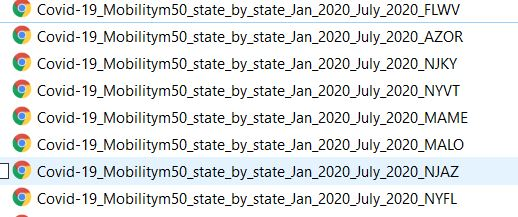

Refer to site for plot: https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_NYFL.html <br>
Refer to site for plot:https://akrishn986.github.ioCovid19-Cause-EffectAnalysis//Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_NJAZ.html  <br>
Refer to site for plot:https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_MALO.html   <br>
Refer to site for plot:https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_MAME.html  <br>
Refer to site for plot:https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_NYVT.html  <br>
Refer to site for plot:https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_NJKY.html  <br>
Refer to site for plot:https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_AZOR.html  <br>
Refer to site for plot:https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50_state_by_state_Jan_2020_July_2020_FLWV.html  <br>

## <font color=darkgreen > 7A. Visualizing average median mobility by day using a timelapse video </font>

In [51]:
#Plot mobility average of median vs cases per week delayed by 3 weeks
data_DL_Mobility.head(2)

,date,country_code,admin_level,admin1,fips,samples,m50,m50_index
0,2020-03-01,US,1,Alabama,1.0000000,133826,8.3310000,79
1,2020-03-02,US,1,Alabama,1.0000000,143632,10.3980000,98


In [52]:
data_DL_Mobility['Day']=data_DL_Mobility['date'].dt.dayofyear
data_DL_MobilitypltdayVid=data_DL_Mobility.sort_values(by=['admin1','Day'], ascending=True)
data_DL_MobilitypltdayVid=data_DL_MobilitypltdayVid.loc[:,['admin1','Day','m50']]
data_DL_MobilitypltdayVid.rename(columns={'admin1': 'state'},inplace=True)
data_DL_MobilitypltdayVid= data_DL_MobilitypltdayVid[data_DL_MobilitypltdayVid.state.isin(data_covid_perday['state'].unique())]
data_DL_MobilitypltdayVid = contiguous_usa.merge(data_DL_MobilitypltdayVid, left_on = 'NAME', right_on = 'state')
data_DL_MobilitypltdayVid.head(5)

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry,state,Day,m50
0,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,61,4.5480000
1,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,62,7.7580000
2,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,63,7.7240000
3,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,64,7.9120000
4,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,65,8.3060000


In [53]:
data_DL_MobilitypltdayVid['Day'].min()

61

In [54]:
data_DL_MobilitypltdayVid['Day'].max()

200

In [55]:
from bokeh.io import export_png
from bokeh.io import export_svgs
from bokeh.themes import built_in_themes

In [56]:
def bkpltmobday(dayst,dayend):
    for i in range(dayst,dayend): ## rerun from 110, 150 - misisng data
        if i in (111,151):
            continue
        data_DL_Mobilitypltdaymap=data_DL_MobilitypltdayVid[(data_DL_MobilitypltdayVid['Day']==i)]
        geosourcemblitdymap = GeoJSONDataSource(geojson = data_DL_Mobilitypltdaymap.to_json())
        # Define color palettes
        palettepc = magma(60)
        palettepc = palettepc[::-1] # reverse order of colors so higher values have darker colors
        # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
        color_mapperpc = LinearColorMapper(palette = palettepc, low =data_DL_Mobilitypltdaymap['m50'].min(), 
                                          high = data_DL_Mobilitypltdaymap['m50'].max())
    
        # Create color bar.
        color_bar = ColorBar(color_mapper = color_mapperpc, 
                            label_standoff = 8,
                            width = 500, height = 20,
                            border_line_color = None,
                            location = (0,0), 
                            orientation = 'horizontal')

        # Create figure object.
        pc = figure(title='Day {}'.format(i),plot_height = 500 ,
                    plot_width = 550, )
        pc.toolbar.logo = None
        pc.toolbar_location = None
        pc.axis.visible = False
        pc.xgrid.visible = False
        pc.ygrid.visible = False
        pc.min_border_left = 0
        pc.min_border_right = 0
        pc.min_border_top = 0
        pc.min_border_bottom = 0
        pc.background_fill_alpha = 0.8
        pc.background_fill_color = 'Black'
        states = pc.patches('xs','ys', source = geosourcemblitdymap,
                            fill_color = {'field' :'m50',
                                            'transform' : color_mapperpc},
                            line_color = 'gray', 
                            line_width = 0.25, 
                            fill_alpha = 1) 
        if len(str(i))==2:
            fname=('PNGIMG\outputimage_day00{}.png'.format(i))
        else:
            fname=('PNGIMG\outputimage_day0{}.png'.format(i))
        export_png(pc, filename=fname)

In [57]:
bkpltmobday(61,111)

In [58]:
bkpltmobday(112,150)

In [59]:
bkpltmobday(151,201)

In [60]:
import os
import moviepy.video.io.ImageSequenceClip
image_folder='PNGIMG'
fps=5

import re

def natural_sort_key(s, _nsre=re.compile('([0-9]+)')):
    return [
        int(text)
        if text.isdigit() else text.lower()
        for text in _nsre.split(s)]
    

image_files = [image_folder+'/'+img for img in os.listdir(image_folder) if img.endswith(".png")]
sorted_images = sorted(image_files, key=natural_sort_key)
clip = moviepy.video.io.ImageSequenceClip.ImageSequenceClip(sorted_images, fps=fps)
clip.write_videofile('MobilitybyDayTimeLapse.mp4')

t:   0%|                                                                             | 0/137 [00:00<?, ?it/s, now=None]

Moviepy - Building video MobilitybyDayTimeLapse.mp4.
Moviepy - Writing video MobilitybyDayTimeLapse.mp4



Moviepy - Done !
Moviepy - video ready MobilitybyDayTimeLapse.mp4


In [61]:
from IPython.display import HTML

HTML("""
    <video alt="test" controls>
        <source src="MobilitybyDayTimeLapse.mp4" type="video/mp4">
    </video>
""")

https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/MobilitybyDayTimeLapse.mp4

## <font color=darkgreen > 7B. Visualizing average median mobility per week against delayed case ratio per week by state </font>

In [62]:
data_DL_Mobilitypltwkmap=data_DL_Mobilityplt.sort_values(by=['state','date'], ascending=True)
#Average of the median values per week
data_DL_Mobilitypltwkmap=data_DL_Mobilitypltwkmap.groupby(['state','Week'])[['m50']].mean()
data_DL_Mobilitypltwkmap.reset_index(inplace=True)
data_DL_Mobilitypltwkmap.rename(columns={'m50': 'Averagemedian50'},inplace=True)
data_DL_Mobilitypltwkmap = contiguous_usa.merge(data_DL_Mobilitypltwkmap, left_on = 'NAME', right_on = 'state')
data_DL_Mobilitypltwkmap.head(2)

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry,state,Week,Averagemedian50
0,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,10,6.8825000
1,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,11,6.3197143


In [63]:
data_DL_Mobilitypltwkmap['Averagemedian50'].min()

0.023571428571428573

In [64]:
data_DL_Mobilitypltwkmap['Averagemedian50'].max()

10.983166666666667

In [65]:
data_DL_Mobilitypltwkmap['Week'].min()

9

In [66]:
data_DL_Mobilitypltwkmap['Week'].max()

29

In [67]:
data_covid_perweekmapdata=data_covid_perweek.sort_values(by=['state',"Week"], ascending=True)
data_covid_perweekmapdata = contiguous_usa.merge(data_covid_perweekmapdata, left_on = 'NAME', right_on = 'state')

In [68]:
data_covid_perweekmapdata['caseperweekratio'].max()

3764.7900539273

In [69]:
data_covid_perweekmapdata['caseperweekratio'].min()

0.0

In [70]:
# Multiple map plots per week
def bkplt71():
    plots71=[]
    for i in range(9,data_DL_Mobilitypltwkmap['Week'].max()-4): 
        data_DL_Mobilitypltwkmapnew=data_DL_Mobilitypltwkmap[(data_DL_Mobilitypltwkmap['Week']==i)]
        geosourcemblitywkmap = GeoJSONDataSource(geojson = data_DL_Mobilitypltwkmapnew.to_json())
        # Define color palettes
        palettep71 = magma(60)
        palettep71 = palettep71[::-1] # reverse order of colors so higher values have darker colors
        # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
        color_mapperp71 = LinearColorMapper(palette = palettep71, low =data_DL_Mobilitypltwkmapnew['Averagemedian50'].min(), 
                                          high = data_DL_Mobilitypltwkmapnew['Averagemedian50'].max())
        tick_labelsp71 = {'0': '0', '50': '50','80':'80','100':'100','150':'150','200':'200','300':'300'}
        # Create color bar.
        color_bar = ColorBar(color_mapper = color_mapperp71, 
                            label_standoff = 8,
                            width = 500, height = 20,
                            border_line_color = None,
                            location = (0,0), 
                            orientation = 'horizontal',
                            major_label_overrides = tick_labelsp71)

        # Create figure object.
        p71 = figure(title = 'Average Median Mobility per Week {} by State '.format(i), 
                    plot_height = 500 ,
                    plot_width = 550, 
                    toolbar_location = 'left',
                    tools = "pan, wheel_zoom, box_zoom, reset")
        p71.xgrid.grid_line_color = None
        p71.ygrid.grid_line_color = None
        # Add patch renderer to figure.
        states = p71.patches('xs','ys', source = geosourcemblitywkmap,
                            fill_color = {'field' :'Averagemedian50',
                                            'transform' : color_mapperp71},
                            line_color = 'gray', 
                            line_width = 0.25, 
                            fill_alpha = 1)
        p71.title.text_color = "Black"
        p71.title.text_font = "Segoe UI"
        p71.title.text_font_style = "bold italic"
        p71.title.align ='center'
        p71.title.text_font_size="10pt"
        # Create hover tool
        p71.add_tools(HoverTool(renderers = [states],
                        tooltips = [('state','@NAME'),
                                  ('Average median Mobility by Week','@Averagemedian50')]))
        # Specify layout
        p71.add_layout(color_bar, 'below')
        plots71.append(p71)
    return plots71

In [71]:
# Multiple map plots per week
def bkplt72():
    plots72=[]
    for i in range(13,data_covid_perweekmapdata['Week'].max()): 
        data_covid_perweekmapdatanew=data_covid_perweekmapdata[(data_covid_perweekmapdata['Week']==i)]
        geosourcecovid_perweekmap = GeoJSONDataSource(geojson = data_covid_perweekmapdatanew.to_json())
        # Define color palettes
        palettep72 = magma(60)
        palettep72 = palettep72[::-1] # reverse order of colors so higher values have darker colors
        # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
        color_mapperp72 = LinearColorMapper(palette = palettep72, low =data_covid_perweekmapdatanew['caseperweekratio'].min(), 
                                          high = data_covid_perweekmapdatanew['caseperweekratio'].max())

        # Define custom tick labels for color bar.
        tick_labelsp72 = {'0': '0', '50': '50','80':'80','100':'100','150':'150','200':'200','300':'300'}

        # Create color bar.
        color_bar = ColorBar(color_mapper = color_mapperp72, 
                            label_standoff = 8,
                            width = 500, height = 20,
                            border_line_color = None,
                            location = (0,0), 
                            orientation = 'horizontal',
                            major_label_overrides = tick_labelsp72)

        # Create figure object.
        p72 = figure(title = 'Covid case ratio per Week {} by State '.format(i), 
                    plot_height = 500 ,
                    plot_width = 550, 
                    toolbar_location = 'left',
                    tools = "pan, wheel_zoom, box_zoom, reset")
        p72.xgrid.grid_line_color = None
        p72.ygrid.grid_line_color = None
        # Add patch renderer to figure.
        states = p72.patches('xs','ys', source = geosourcecovid_perweekmap,
                            fill_color = {'field' :'caseperweekratio',
                                            'transform' : color_mapperp72},
                            line_color = 'gray', 
                            line_width = 0.25, 
                            fill_alpha = 1)
        p72.title.text_color = "Black"
        p72.title.text_font = "Segoe UI"
        p72.title.text_font_style = "bold italic"
        p72.title.align ='center'
        p72.title.text_font_size="10pt"
        # Create hover tool
        p72.add_tools(HoverTool(renderers = [states],
                        tooltips = [('state','@NAME'),
                                  ('Caseratio by Week','@caseperweekratio')]))
        # Specify layout
        p72.add_layout(color_bar, 'below')
        plots72.append(p72)
    return plots72

In [72]:
def pltlayout():
    plots71=bkplt71()
    plots72=bkplt72()

    layout1=layout(Div(text='Figure 7.1', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                     ,[plots71[0],plots71[1],plots71[2],plots71[3]]
                     ,[plots72[0],plots72[1],plots72[2],plots72[3]])
    layout2=layout(Div(text='Figure 7.2', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                     ,[plots71[4],plots71[5],plots71[6],plots71[7]]
                     ,[plots72[4],plots72[5],plots72[6],plots72[7]])
    layout3=layout(Div(text='Figure 7.3', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                     ,[plots71[8],plots71[9],plots71[10],plots71[11]]
                     ,[plots72[8],plots72[9],plots72[10],plots72[11]])
    layout4=layout(Div(text='Figure 7.4', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                     ,[plots71[12],plots71[13],plots71[14],plots71[15]]
                     ,[plots72[12],plots72[13],plots72[14],plots72[15]])
    tab1 = Panel(child=layout1, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab1")
    tab2 = Panel(child=layout2, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab2")
    tab3 = Panel(child=layout3, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab3")
    tab4 = Panel(child=layout4, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab4")
    Finlayout7=Tabs(tabs=[tab1,tab2,tab3,tab4],sizing_mode='scale_width')
    try:
            bop.reset_output()
            bop.output_notebook()
            bop.show(Finlayout7)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_week_byweek_Jan_2020_July_2020.html')        
            save(Finlayout7,notebook_handle=True)
    except:
            bop.output_notebook()
            bop.show(Finlayout7)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_week_byweek_Jan_2020_July_2020.html')        
            save(Finlayout7,notebook_handle=True)

In [73]:
def pltlayoutalt():
    plots71=bkplt71()
    plots72=bkplt72()

    layout1=layout(Div(text='Figure 7.1', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                     ,[plots71[0],plots72[0]]
                     ,[plots71[1],plots72[1]]
                     ,[plots71[2],plots72[2]]
                     ,[plots71[3],plots72[3]])
    layout2=layout(Div(text='Figure 7.2', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                   ,[plots71[4],plots72[4]]
                   ,[plots71[5],plots72[5]]
                   ,[plots71[6],plots72[6]]
                   ,[plots71[7],plots72[7]])
    layout3=layout(Div(text='Figure 7.3', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                   ,[plots71[8],plots72[8]]
                   ,[plots71[9],plots72[9]]
                   ,[plots71[10],plots72[10]]
                   ,[plots71[11],plots72[11]])
    layout4=layout([Div(text='Figure 7.4', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                    ,plots71[12],plots72[12]]
                    ,[plots71[13],plots72[13]]
                    ,[plots71[14],plots72[14]]
                    ,[plots71[15],plots72[15]])
    tab1 = Panel(child=layout1, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab1")
    tab2 = Panel(child=layout2, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab2")
    tab3 = Panel(child=layout3, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab3")
    tab4 = Panel(child=layout4, title="Week by Week Comparison of Mobility And Covid Case Ratio Tab4")
    Finlayout7=Tabs(tabs=[tab1,tab2,tab3,tab4],sizing_mode='scale_width')
    try:
            bop.reset_output()
            bop.output_notebook()
            bop.show(Finlayout7)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_week_byweek_Jan_2020_July_2020.html')        
            save(Finlayout7,notebook_handle=True)
    except:
            bop.output_notebook()
            bop.show(Finlayout7)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_week_byweek_Jan_2020_July_2020.html')        
            save(Finlayout7,notebook_handle=True)

In [74]:
pltlayout()

Loading BokehJS ...

The choropleth maps visualized, allows us to compare the mobility median values agaisnt the covid case ratio with a delay of 3 weeks. <br>
Refer to site for plot: https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50andCaseRatio_week_byweek_Jan_2020_July_2020.html

## <font color=darkgreen > 8. Visualizing Mobility data based on for relative change per Month for  Least affected states

In [75]:
# Take state & month and average median values & create dataframe for geojson
data_DL_Mobilitypltmonmap=data_DL_Mobilityplt.sort_values(by=['state','date'], ascending=True)
#Average median of the values to plot the baseline
data_DL_Mobilitypltmonmap=data_DL_Mobilitypltmonmap.groupby(['state','Month'])[['m50']].mean()
data_DL_Mobilitypltmonmap.reset_index(inplace=True)
data_DL_Mobilitypltmonmap.rename(columns={'m50': 'MonthlyAveragemedian50'},inplace=True)
data_DL_Mobilitypltmonmap = contiguous_usa.merge(data_DL_Mobilitypltmonmap, left_on = 'NAME', right_on = 'state')
data_DL_Mobilitypltmonmap.head(2)

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry,state,Month,MonthlyAveragemedian50
0,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,3,3.3464074
1,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,4,0.1891379


In [76]:
data_DL_Mobilitypltmonmap['MonthlyAveragemedian50'].min()

0.02744827586206898

In [77]:
data_DL_Mobilitypltmonmap['MonthlyAveragemedian50'].max()

10.467888888888886

In [78]:
data_DL_Mobilitypltmonmap['Month'].min()

3

In [79]:
# Multiple map plots per week
def bkplt81():
    plots81=[]
    for i in range(data_DL_Mobilitypltmonmap['Month'].min(),data_DL_Mobilitypltmonmap['Month'].max()): 
        data_DL_Mobilitypltmonmapnew=data_DL_Mobilitypltmonmap[(data_DL_Mobilitypltmonmap['Month']==i)]
        geosourcemonmobmap = GeoJSONDataSource(geojson = data_DL_Mobilitypltmonmapnew.to_json())
        # Define color palettes
        palettep81 = viridis(30)
        palettep81 = palettep81[::-1] # reverse order of colors so higher values have darker colors
        # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
        color_mapperp81 = LinearColorMapper(palette = palettep81, low =data_DL_Mobilitypltmonmapnew['MonthlyAveragemedian50'].min(), 
                                          high = data_DL_Mobilitypltmonmapnew['MonthlyAveragemedian50'].max())

        # Define custom tick labels for color bar.
        tick_labelsp81 = {'0': '0', '50': '50','80':'80','100':'100','150':'150','200':'200','300':'300'}

        # Create color bar.
        color_bar = ColorBar(color_mapper = color_mapperp81, 
                            label_standoff = 8,
                            width = 500, height = 20,
                            border_line_color = None,
                            location = (0,0), 
                            orientation = 'horizontal',
                            major_label_overrides = tick_labelsp81)

        # Create figure object.
        p81 = figure(title = 'Covid Average Median Mobility per Month {} by State '.format(i), 
                    plot_height = 500 ,
                    plot_width = 575, 
                    toolbar_location = 'left',
                    tools = "pan, wheel_zoom, box_zoom, reset")
        p81.xgrid.grid_line_color = None
        p81.ygrid.grid_line_color = None
        # Add patch renderer to figure.
        states = p81.patches('xs','ys', source = geosourcemonmobmap,
                            fill_color = {'field' :'MonthlyAveragemedian50',
                                            'transform' : color_mapperp81},
                            line_color = 'gray', 
                            line_width = 0.25, 
                            fill_alpha = 1)
        p81.title.text_color = "Black"
        p81.title.text_font = "Segoe UI"
        p81.title.text_font_style = "bold italic"
        p81.title.align ='center'
        p81.title.text_font_size="10pt"
        # Create hover tool
        p81.add_tools(HoverTool(renderers = [states],
                        tooltips = [('state','@NAME'),
                                  ('Monthly median average Mobility by Month','@MonthlyAveragemedian50')]))
        # Specify layout
        p81.add_layout(color_bar, 'below')
        plots81.append(p81)
    return plots81

In [80]:
data_covid_perMonth.head(2)

,state,Month,population,casepermonth,caseperMonthratio,rankrev4,rank4
0,Alabama,3,4888949,999.0000000,204.3383967,19.0000000,31.0000000
1,Alabama,4,4888949,6069.0000000,1241.3711004,20.0000000,30.0000000


In [81]:
data_covid_perMonthmonmap = contiguous_usa.merge(data_covid_perMonth, left_on = 'NAME', right_on = 'state')
data_covid_perMonthmonmap.head(2)

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry,state,Month,population,casepermonth,caseperMonthratio,rankrev4,rank4
0,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,3,6079602,1662.0000000,273.3731583,27.0000000,23.0000000
1,24,01714934,0400000US24,24,MD,Maryland,00,25151100280,6979966958,"MULTIPOLYGON (((-76.04621 38.02553, -76.00734 ...",Maryland,4,6079602,20163.0000000,3316.4999946,38.0000000,12.0000000


In [82]:
# Multiple map plots per week
def bkplt82():
    plots82=[]
    for i in range(data_DL_Mobilitypltmonmap['Month'].min()+1,data_DL_Mobilitypltmonmap['Month'].max()+1): 
        data_covid_perMonthmapnew=data_covid_perMonthmonmap[(data_covid_perMonthmonmap['Month']==i)]
        geosourcemonmcovmap = GeoJSONDataSource(geojson = data_covid_perMonthmapnew.to_json())
        # Define color palettes
        palettep82 = viridis(30)
        palettep82 = palettep82[::-1] # reverse order of colors so higher values have darker colors
        # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
        color_mapperp82 = LinearColorMapper(palette = palettep82, low =data_covid_perMonthmonmap['caseperMonthratio'].min(), 
                                          high = data_covid_perMonthmonmap['caseperMonthratio'].max())

        # Define custom tick labels for color bar.
        tick_labelsp82 = {'0': '0', '50': '50','80':'80','100':'100','150':'150','200':'200','300':'300'}

        # Create color bar.
        color_bar = ColorBar(color_mapper = color_mapperp82, 
                            label_standoff = 8,
                            width = 500, height = 20,
                            border_line_color = None,
                            location = (0,0), 
                            orientation = 'horizontal',
                            major_label_overrides = tick_labelsp82)

        # Create figure object.
        p82 = figure(title = 'Covid case ratio per Month {} by State '.format(i), 
                    plot_height = 500 ,
                    plot_width = 575, 
                    toolbar_location = 'left',
                    tools = "pan, wheel_zoom, box_zoom, reset")
        p82.xgrid.grid_line_color = None
        p82.ygrid.grid_line_color = None
        # Add patch renderer to figure.
        states = p82.patches('xs','ys', source = geosourcemonmcovmap,
                            fill_color = {'field' :'caseperMonthratio',
                                            'transform' : color_mapperp82},
                            line_color = 'gray', 
                            line_width = 0.25, 
                            fill_alpha = 1)
        p82.title.text_color = "Black"
        p82.title.text_font = "Segoe UI"
        p82.title.text_font_style = "bold italic"
        p82.title.align ='center'
        p82.title.text_font_size="10pt"
        # Create hover tool
        p82.add_tools(HoverTool(renderers = [states],
                        tooltips = [('state','@NAME'),
                                  ('Case Ratio by Month','@caseperMonthratio')]))
        # Specify layout
        p82.add_layout(color_bar, 'below')
        plots82.append(p82)
    return plots82

In [83]:
def pltlayout2():
    plots81=bkplt81()
    plots82=bkplt82()
    layout1=layout(Div(text='Figure 8.1', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                    ,[plots81[0],plots81[1],plots81[2],plots81[3]]
                    ,[plots82[0],plots82[1],plots82[2],plots82[3]])
    tab1 = Panel(child=layout1, title=" Month by Month comparison of mobility data vs case ratio")
    Finlayout8=Tabs(tabs=[tab1],sizing_mode='scale_width')
    try:
            bop.reset_output()
            bop.output_notebook()
            bop.show(Finlayout8)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_Month_by_Month_Jan_2020_July_2020.html')        
            save(Finlayout8,notebook_handle=True)
    except:
            bop.output_notebook()
            bop.show(Finlayout8)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_Month_by_Month_Jan_2020_July_2020.html')        
            save(Finlayout8,notebook_handle=True)

In [84]:
def pltlayout2alt():
    plots81=bkplt81()
    plots82=bkplt82()
    layout1=layout(Div(text='Figure 8.1', style={'font-size': '100%', 'color': 'blue','align-self': 'flex-end'})
                    ,[plots81[0],plots82[0]]
                    ,[plots81[1],plots82[1]]
                    ,[plots81[2],plots82[2]]
                    ,[plots81[3],plots82[3]])
    tab1 = Panel(child=layout1, title=" Month by Month comparison of mobility data vs case ratio")
    Finlayout8=Tabs(tabs=[tab1],sizing_mode='scale_width')
    try:
            bop.reset_output()
            bop.output_notebook()
            bop.show(Finlayout8)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_Month_by_Month_Jan_2020_July_2020.html')        
            save(Finlayout8,notebook_handle=True)
    except:
            bop.output_notebook()
            bop.show(Finlayout8)
            # create an output file 
            output_file('Covid-19_Mobilitym50andCaseRatio_Month_by_Month_Jan_2020_July_2020.html')        
            save(Finlayout8,notebook_handle=True)

In [85]:
pltlayout2()
#Refer to site for plot: https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Mobilitym50andCaseRatio_week_byweek_Jan_2020_July_2020.html

Loading BokehJS ...

For the least affected stated we can see that except for month 4, they have consistent state of less relative mobility. 

## <font color=darkgreen > 9. Visualizing Open table's Diner data & Diner Reopened data in heat map

In [86]:
seated_diner_data = pd.read_csv('YoY_Seated_Diner_Data.csv')
seated_diner_data=seated_diner_data[(seated_diner_data['Type']=='state')]
seated_diner_data.head(5)

,Type,Name,2/18,2/19,2/20,2/21,2/22,2/23,2/24,2/25,...,7/1,7/2,7/3,7/4,7/5,7/6,7/7,7/8,7/9,7/10
8,state,Alabama,-14,7,1,-2,8,2,1,0,...,-43.2600000,-7.1600000,-47.3700000,-69.4600000,-53.3800000,-57.2300000,-53.7300000,-51.4300000,-53.7800000,-48.0400000
9,state,Alberta,2,10,2,1,5,0,-1,3,...,-16.0100000,-50.3400000,-36.7700000,-81.2700000,-45.4900000,-51.6400000,-56.1600000,-47.3400000,-40.2800000,-33.8800000
10,state,Arizona,0,1,8,4,-3,5,2,5,...,-68.1100000,-64.4300000,-57.1400000,-70.4700000,-61.6800000,-65.5400000,-65.8700000,-67.1800000,-63.7400000,-62.7100000
11,state,Baja California Sur,-6,-2,-2,-9,1,1,29,6,...,-81.6600000,-73.4300000,-68.9900000,-54.8600000,-52.5200000,-58.8600000,-60.4900000,-57.2500000,-57.1000000,-51.8300000
12,state,British Columbia,8,-3,1,6,3,-2,-3,-5,...,-33.6200000,-53.2400000,-48.8700000,-87.1200000,-38.3200000,-47.2200000,-48.2800000,-42.3600000,-48.7100000,-40.0800000


In [87]:
# diner reopen and close heat map per state per Day
seated_diner_data = pd.read_csv('YoY_Seated_Diner_Data.csv')
seated_diner_data=seated_diner_data[(seated_diner_data['Type']=='state')]
seated_diner_data=seated_diner_data.melt(id_vars=["Type", "Name"], var_name="Date",value_name="Value")
seated_diner_data['Date']=seated_diner_data['Date'].astype(str)
seated_diner_data.drop(columns=['Type'],inplace=True)
len(seated_diner_data['Name'].unique())

49

In [88]:
seated_diner_data.head(2)

,Name,Date,Value
0,Alabama,2/18,-14.0000000
1,Alberta,2/18,2.0000000


In [89]:
YoY_Reopened_Seated_Diner_Data = pd.read_csv('YoY_Reopened_Seated_Diner_Data.csv')
YoY_Reopened_Seated_Diner_Data=YoY_Reopened_Seated_Diner_Data[(YoY_Reopened_Seated_Diner_Data['Type']=='state')]
YoY_Reopened_Seated_Diner_Data=YoY_Reopened_Seated_Diner_Data.melt(id_vars=["Type", "Name"], var_name="Date",value_name="Value")
YoY_Reopened_Seated_Diner_Data['Date']=YoY_Reopened_Seated_Diner_Data['Date'].astype(str)
YoY_Reopened_Seated_Diner_Data.drop(columns=['Type'],inplace=True)
YoY_Reopened_Seated_Diner_Data.fillna(0,inplace=True)
YoY_Reopened_Seated_Diner_Data.head(2)

,Name,Date,Value
0,California,4/1,0.0000000
1,Florida,4/1,0.0000000


In [90]:
data_covid_perday.head(2)

,state,population,date,caseperday,caseperdayratio,cases,Week,Month,rankrev2,rank2
3419,Alabama,4888949,2020-03-13,6.0000000,1.2272576,6,11,3,21.0000000,20.0000000
3420,Alabama,4888949,2020-03-14,6.0000000,1.2272576,12,11,3,19.0000000,24.0000000


In [91]:
data_covid_perday=data_covid_perday.sort_values(by=['state','date'], ascending=True)
data_covid_perday['relcaseperdayratio']=data_covid_perday.groupby(['caseperdayratio'])['cases'].pct_change(14)
data_covid_perdayhm=data_covid_perday.loc[:,['state','date','caseperdayratio','relcaseperdayratio']]
data_covid_perdayhm=data_covid_perdayhm[(data_covid_perdayhm['date'] > '2020-03-12')]
data_covid_perdayhm['date']=data_covid_perdayhm.date.dt.strftime('%m/%d').str.lstrip('0')
data_covid_perdayhm['date']=data_covid_perdayhm['date'].astype(str)
data_covid_perdayhm.fillna(0,inplace=True)
data_covid_perdayhm.head(2)

,state,date,caseperdayratio,relcaseperdayratio
3419,Alabama,3/13,1.2272576,0.0000000
3420,Alabama,3/14,1.2272576,0.0000000


In [92]:
# heat map 1
def bkplt91(Dinerplots):
        source = ColumnDataSource(seated_diner_data)
        colorsp9 =cividis(40)
        colorsp9 = colorsp9[::-1]
        mapperp9 = LinearColorMapper(palette=colorsp9, low=seated_diner_data.Value.min(), high=seated_diner_data.Value.max())

        p9 = figure(plot_width=1500, plot_height=600
                    , title="US Diner Closing Data during Covid-19"
                    ,x_range=seated_diner_data.Date.unique()
                    , y_range=seated_diner_data.Name.unique()
                    ,x_axis_location="above"
                   ,toolbar_location = 'left',tools = "pan, wheel_zoom, box_zoom, reset")

        p9.rect(x='Date', y='Name', width=1, height=1, source=source,line_color=None, fill_color=transform('Value', mapperp9))

        color_barp9 = ColorBar(color_mapper=mapperp9, location=(0, 0)
                             ,ticker=BasicTicker(desired_num_ticks=len(colorsp9))
                             ,formatter=PrintfTickFormatter(format="%d%%"))

        p9.add_layout(color_barp9, 'right')
        p9.axis.axis_line_color = None
        p9.axis.major_tick_line_color = None
        p9.axis.major_label_text_font_size = "11px"
        p9.axis.axis_label_text_font_size = "12px"
        p9.axis.major_label_standoff = 0
        p9.xaxis.major_label_orientation = 1.5
        p9.title.text_color = "Black"
        p9.title.text_font = "Segoe UI"
        p9.title.text_font_style = "bold italic"
        p9.title.align ='center'
        p9.title.text_font_size="15px"
        # Create hover tool
        p9.add_tools(HoverTool(tooltips = [('state','@Name'),('YoY Close of Diner visits','@Value'+ '%'),('Date','@Date')]))
        p9.add_layout(Title(text="Figure 9.1", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
        Dinerplots.append(p9)
        return Dinerplots

In [93]:
# heat map 2
def bkplt92(Dinerplots):
        source = ColumnDataSource(data_covid_perdayhm)
        colorsr9 =cividis(40)
        colorsr9 = colorsr9[::-1]
        mapperr9 = LinearColorMapper(palette=colorsr9, low=data_covid_perdayhm.caseperdayratio.min(), high=data_covid_perdayhm.caseperdayratio.max())

        r9 = figure(plot_width=1500, plot_height=600
                    , title="US Confirmed Cases per day during Covid-19"
                    ,x_range=data_covid_perdayhm.date.unique()
                    ,y_range=data_covid_perdayhm.state.unique()
                    ,x_axis_location="above"
                    ,toolbar_location = 'left',tools = "pan, wheel_zoom, box_zoom, reset")

        r9.rect(x='date', y='state', width=1, height=1, source=source,line_color=None, fill_color=transform('caseperdayratio', mapperr9))

        color_barr9 = ColorBar(color_mapper=mapperr9, location=(0, 0)
                             ,ticker=BasicTicker(desired_num_ticks=len(colorsr9))
                             ,formatter=PrintfTickFormatter(format="%d%%"))

        r9.add_layout(color_barr9, 'right')
        r9.axis.axis_line_color = None
        r9.axis.major_tick_line_color = None
        r9.axis.major_label_text_font_size = "11px"
        r9.axis.axis_label_text_font_size = "12px"
        r9.axis.major_label_standoff = 0
        r9.xaxis.major_label_orientation = 1.5
        r9.title.text_color = "Black"
        r9.title.text_font = "Segoe UI"
        r9.title.text_font_style = "bold italic"
        r9.title.align ='center'
        r9.title.text_font_size="15px"
        # Create hover tool
        r9.add_tools(HoverTool(tooltips = [('state','@state'),('Covid19 Case Ratio','@caseperdayratio'+ '%'),('Date','@date')]))
        r9.add_layout(Title(text="Figure 9.2", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
        Dinerplots.append(r9)
        return Dinerplots

In [94]:
# heat map 3
def bkplt93(Dinerplots):
    source = ColumnDataSource(YoY_Reopened_Seated_Diner_Data)
    colorsq9 =cividis(40)
    colorsq9 = colorsq9[::-1]
    mapperq9 = LinearColorMapper(palette=colorsq9, low=YoY_Reopened_Seated_Diner_Data.Value.min(), high=YoY_Reopened_Seated_Diner_Data.Value.max())

    q9 = figure(plot_width=1200, plot_height=600, title="US Reopened Diner Data during Covid-19",
               x_range=YoY_Reopened_Seated_Diner_Data.Date.unique(), y_range=YoY_Reopened_Seated_Diner_Data.Name.unique(),
              x_axis_location="above"
               ,toolbar_location = 'left',tools = "pan, wheel_zoom, box_zoom, reset")

    q9.rect(x='Date', y='Name', width=1, height=1, source=source,line_color=None, fill_color=transform('Value', mapperq9))

    color_barq9 = ColorBar(color_mapper=mapperq9, location=(0, 0)
                         ,ticker=BasicTicker(desired_num_ticks=len(colorsq9))
                         ,formatter=PrintfTickFormatter(format="%d%%"))

    q9.add_layout(color_barq9, 'right')
    q9.axis.axis_line_color = None
    q9.axis.major_tick_line_color = None
    q9.axis.major_label_text_font_size = "11px"
    q9.axis.axis_label_text_font_size = "12px"
    q9.axis.major_label_standoff = 0
    q9.xaxis.major_label_orientation = 1.5
    q9.title.text_color = "Black"
    q9.title.text_font = "Segoe UI"
    q9.title.text_font_style = "bold italic"
    q9.title.align ='center'
    q9.title.text_font_size="15px"
        # Create hover tool
    q9.add_tools(HoverTool(tooltips = [('state','@Name'),('Diner Reopening','@Value'+ '%'),('Date','@Date')]))
    q9.add_layout(Title(text="Figure 9.3", text_font_size="12pt",text_font_style='italic',text_color='blue'), 'below')
    Dinerplots.append(q9)
    return Dinerplots

In [95]:
Dinerplots=[]
Dinerplots1=bkplt91(Dinerplots)
Dinerplots2=bkplt92(Dinerplots1)
Dinerplots3=bkplt93(Dinerplots2)

layout1=layout([Dinerplots3[0]
                 ,Dinerplots3[1]
               ,Dinerplots3[2]])
tab1 = Panel(child=layout1, title="Diner Closing and Case Ratio comparison")
Finlayout9=Tabs(tabs=[tab1],sizing_mode='scale_width')
try:
        bop.reset_output()
        bop.output_notebook()
        bop.show(Finlayout9)
        # create an output file 
        output_file('Covid-19_Diner_Closing_and_Case_Ratio_comparison_Jan_2020_July_2020.html')        
        save(Finlayout9,notebook_handle=True)
except:
        bop.output_notebook()
        bop.show(Finlayout9)
        # create an output file 
        output_file('Covid-19_Diner_Closing_and_Case_Ratio_comparison_Jan_2020_July_2020.html')        
        save(Finlayout9,notebook_handle=True)

Loading BokehJS ...

In Figure 9.1, the values indicate the percentage change of seated diners and restaurant visits, compared to the same week last year. We can see that the most affected states did not close diners completely and had positive values until 4/1.District of Columbia and New Jersey had peak visits in Feb, However, there is not an observable pattern or relationship seen for the most affected states. As for least affected states, they do not have any significant data that can be represented on the heap map.  <br>
 <br>
 <br>
In Figure 9.3, It can seen that all 3 of the most affected states have opened for business mid june 

<br> Due to Lack of patterns in the Diner data, I will not be pursuing it for the causal analysis. 

<br> Refer to site for plot: https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/Covid-19_Diner_Closing_and_Case_Ratio_comparison_Jan_2020_July_2020.html


## <font color=darkgreen > 10. Granger causality Analysis for Mobility Data (Most affected & Least affected states)

Reference: https://towardsdatascience.com/granger-causality-and-vector-auto-regressive-model-for-time-series-forecasting-3226a64889a6

For the causal analysis the mobility data merged with case ratio will be used : data_DL_MobilitypltH /data_DL_MobilitypltL. <br>
Considering data for only the mostr affected and least affected states.

In [96]:
data_DL_Mobilityplt.head(2)

,date,country_code,admin_level,admin1,fips,samples,m50,m50_index,state,population,caseperday,caseperdayratio,cases,Week,Month,rankrev2,rank2
0,2020-03-13,US,1,Alabama,1.0000000,138766,12.2690000,116,Alabama,4888949,6.0000000,1.2272576,6,11,3,21.0000000,20.0000000
1,2020-03-14,US,1,Alabama,1.0000000,135267,9.3790000,89,Alabama,4888949,6.0000000,1.2272576,12,11,3,19.0000000,24.0000000


In [97]:
data_DL_Mobilityplt.state.unique()

array(['Alabama', 'Arizona', 'Arkansas', 'California', 'Colorado',
       'Connecticut', 'Delaware', 'Florida', 'Georgia', 'Idaho',
       'Illinois', 'Indiana', 'Iowa', 'Kansas', 'Kentucky', 'Louisiana',
       'Maine', 'Maryland', 'Massachusetts', 'Michigan', 'Minnesota',
       'Mississippi', 'Missouri', 'Montana', 'Nebraska', 'Nevada',
       'New Hampshire', 'New Jersey', 'New Mexico', 'New York',
       'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma', 'Oregon',
       'Pennsylvania', 'Rhode Island', 'South Carolina', 'South Dakota',
       'Tennessee', 'Texas', 'Utah', 'Vermont', 'Virginia', 'Washington',
       'District of Columbia', 'West Virginia', 'Wisconsin', 'Wyoming'],
      dtype=object)

In [98]:
datasetG=data_DL_Mobilityplt.loc[:,['date','state','caseperday','m50']]

In [99]:
def createdf(stateswidget):
    datasetN=datasetG[datasetG['state']==stateswidget]
    datasetN=datasetN.loc[:,['date','caseperday','m50']]
    datasetN['date'] = pd.to_datetime(datasetN['date'], format='%Y-%m-%d')
    datasetN.set_index('date',inplace=True)
    return datasetN

In [100]:
# Plot
def createplot(datasetN, stateswidget):
    fig, axes = plt.subplots(nrows=1, ncols=2, dpi=150, figsize=(5,2))
    for i, ax in enumerate(axes.flatten()):
         data = datasetN[datasetN.columns[i]]
         ax.plot(data, color='red', linewidth=1)
         ax.set_title(datasetN.columns[i],fontsize=8)
         ax.spines['top'].set_alpha(0)
         ax.tick_params(labelsize=6)
         ax.set_ylabel(datasetN.columns[i],fontsize=8)
         ax.set_xlabel("Date",fontsize=8)
         fig.autofmt_xdate()
         plt.tight_layout()
    fig.suptitle('Normality Plot for {}'.format(stateswidget),fontsize=8)
    return plt

In [101]:
from scipy import stats

def normalityvalidationm50(datasetN, stateswidget):
    stat,p = stats.normaltest(datasetN.m50)
    print("Statistics = %.3f, p=%.3f" % (stat,p))
    alpha = 0.05
    if p> alpha:
        print('m50 :: Data looks Gaussian (fail to reject null hypothesis)', sep='\n')
    else:
        print('m50 :: Data looks non-Gaussian (reject null hypothesis)', sep='\n')

In [102]:
def normalityvalidationcase(datasetN, stateswidget):
    stat,p = stats.normaltest(datasetN.caseperday)
    print("Statistics = %.3f, p=%.3f" % (stat,p))
    alpha = 0.05
    if p> alpha:
        print('caseperday:: Data looks Gaussian (fail to reject null hypothesis)', sep='\n')
    else:
        print('caseperday :: Data looks non-Gaussian (reject null hypothesis)', sep='\n')

In [103]:
def normalityplot(datasetN, stateswidget):
    plt.figure(figsize=(14,6))
    plt.subplot(2,2,1)
    #datasetN['m50'].hist(bins=auto)
    plt.hist(datasetN['m50'],bins='auto')
    plt.title('m50 - Histogram') 
    plt.subplot(2,2,2)
    stats.probplot(datasetN['m50'], plot=plt);
    plt.title('Normal Probability Plot for m50 per day {}'.format(stateswidget),fontsize=10)
    plt.figure(figsize=(14,6))
    plt.subplot(2,2,3)
    #datasetN['caseperday'].hist(bins=auto)
    plt.hist(datasetN['caseperday'],bins='auto')
    plt.title('caseperday - Histogram')
    plt.subplot(2,2,4)
    stats.probplot(datasetN['caseperday'], plot=plt)
    plt.title('Normal Probability Plot for case per day {}'.format(stateswidget),fontsize=10)
    plt.show()
    print(datasetN.m50.describe().T,"\nm50 stats{}\n".format(stateswidget))
    print(datasetN.caseperday.describe().T,"\ncaseperday stats for {}\n".format(stateswidget))

In [104]:
import seaborn as sns
def plotcorr(datasetN,stateswidget):
    corr=datasetN.corr()
    ax = plt.axes()
    sns.heatmap(corr,ax = ax,xticklabels=corr.columns.values,yticklabels=corr.columns.values,annot=True,annot_kws={'size':12})
    heat_map=plt.gcf()
    heat_map.set_size_inches(10,6)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    ax.set_title('Correplation Plot for {}'.format(stateswidget),fontsize=8)
    plt.show()

**auto correlation: correlation between the elements of a series and others from the same series separated from them by a given interval.**

In [105]:
import statsmodels.api as sm
def plotacf(datasetN,stateswidget,l):
    for i in datasetN:
        sm.graphics.tsa.plot_acf(datasetN[i], lags = l)
        plt.xlabel('number of lags')
        plt.ylabel('correlation')
        plt.tight_layout()
        plt.title('Autocorrelation Function for %s' % i)
        plt.show()

Granger’s causality Tests the null hypothesis that the coefficients of past values in the regression equation is zero. In simpler terms, the past values of time series (x) do not cause the other series (y). So, if the p-value obtained from the test is lesser than the significance level of 0.05, then, you can safely reject the null hypothesis. This has been performed on original data-set.

Example: Null Hypothesis correlation coefficient is no significantly diff from -0.43 , Our Alternate is that there is a significantly diff relationship from -0.43

In [106]:
stateswidget1=['New York','New Jersey','Arizona', 'Louisiana', 'Florida','District of Columbia','Rhode Island','Massachusetts']
stateswidget2=['Montana', 'Maine', 'Oregon' ,'Kentucky','Vermont','West Virginia']

In [107]:
import statsmodels.api as sm
import statsmodels.tsa.stattools as tsa_stats
from statsmodels.tsa.stattools import grangercausalitytests

In [108]:
def causeandeffect(stateswidget):    
    datasetN=createdf(stateswidget)
    plt=createplot(datasetN,stateswidget)
    plt.show()
    print('Normality test based on the Null and Alternate Hypothesis intuition\n')
    print('\n\n')
    normalityvalidationm50(datasetN,stateswidget)
    print('\n\n')
    normalityvalidationcase(datasetN,stateswidget)
    print('\n\n')
    print('Normal probability plot\n')
    normalityplot(datasetN,stateswidget)
    print('\n\n')
    plotcorr(datasetN,stateswidget)
    print('\n\n')
    plotacf(datasetN,stateswidget,20)
    print('\n\n')
    gr=grangercausalitytests(datasetN[['caseperday', 'm50']], maxlag=4)
    print(gr[2][1][0])   

<style type='text/css'>
.CodeMirror{
font-size: 17px;
</style>

https://www.dummies.com/programming/big-data/data-science/autocorrelation-plots-graphical-technique-for-statistical-data/

There is a positive autocorrelation. Each spike that rises above or falls below the dashed lines is considered to be statistically significant. A spike is significantly different from zero, that is evidence of autocorrelation. A spike that’s close to zero is evidence against autocorrelation.

For granger causality tests, upto 2 lag periods we can see that the null hypothesis can be rejected. However, post the 2nd lag period we can start to see some evidence that the case ratio and mobility maybe related, based on this data it seems to be a weak relationship

In [109]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import ipywidgets as widgets
import numpy as np


def runwidget(stateswidget):
    sub_tab=[widgets.Output() for i,e in enumerate(stateswidget)]
    tab = widgets.Tab(sub_tab)
    for i,e in enumerate(stateswidget):
        tab.set_title(i,"Granger_{}".format(e))
        with sub_tab[i]:
            causeandeffect(e)
    display(tab)

In [110]:
def save_with_widgets ():
    display(HTML('<script>Jupyter.menubar.actions._actions["widgets:save-with-widgets"].handler()</script>') )

In [111]:
from IPython.display import display, HTML

CSS = """
.output {
    align-items: center;
}
"""

HTML('<style>{}</style>'.format(CSS))

In [112]:
save_with_widgets()
runwidget(stateswidget1)

In [113]:
save_with_widgets()
runwidget(stateswidget2)

To determine whether the correlation between variables is significant, compare the p-value to your significance level. Usually, a significance level (denoted as α or alpha) of 0.05 works well. An α of 0.05 indicates that the risk of concluding that a correlation exists—when, actually, no corr<br>
**P-value ≤ α: The correlation is statistically significant**<br>
If the p-value is less than or equal to the significance level, then you can conclude that the correlation is different from 0.<br>
**P-value > α: The correlation is not statistically significant**<br>
If the p-value is greater than the significance level, then you cannot conclude that the correlation is different from 0.<br>

Final html available in https://akrishn986.github.io/Covid19-Cause-EffectAnalysis/EDA_for_COVID-19_Mobility_Patterns_Perpective.html